In [275]:
from datetime import datetime
import os
import geoutils as gu
import geopandas as gpd
import pandas as pd
import numpy as np
import math
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib.patches import FancyArrowPatch
import cartopy.crs as ccrs
from cartopy.mpl.ticker import LongitudeFormatter, LatitudeFormatter
import xdem
import pyproj
import matplotlib.pyplot as plt
from shapely.geometry import box, Point, Polygon

import warnings
warnings.filterwarnings('ignore')

def getFilePathList(path, filetype):
    pathList = []
    for root, dirs, files in os.walk(path):
        for file in files:
            if file.endswith(filetype):
                pathList.append(os.path.join(root, file))
    return pathList  # 输出以filetype为后缀的列表

In [203]:
plt.rcParams['font.family'] = 'Arial'
plt.rcParams['pdf.fonttype'] = 42 
plt.rcParams['ps.fonttype'] = 42 

## Calculate the penetration depth for each grid

In [7]:
dem_diff_dir = r'D:\Geography dataset\HMA_NASADEM\dem_diff_coregistered'
nasadem_path = r'D:\Geography dataset\HMA_NASADEM\NASADEM_coregistered\NASADEM_HMA.tif'
grid10_path = r'E:\HMA\HMA_boundary\HMA_fishnet_10_clip.shp'
glacier_outlines_path = r'E:\HMA\Hugonnet\per_glacier\rgi_hma.shp'

grid10_pdd_savepath = r'E:\revised_NCC_data\ICESat2_result\grid10_pdd\HMA_fishnet_10_clip.shp'
grid10_rgi_savedir = r'E:\revised_NCC_data\grid10_rgi'

dem_diff_paths = getFilePathList(dem_diff_dir, '.tif')
dem_diff_paths

['D:\\Geography dataset\\HMA_NASADEM\\dem_diff_coregistered\\N27E086_N27E086_nuth_x-26.27_y-28.87_z+1.53_align_diff_filt.tif',
 'D:\\Geography dataset\\HMA_NASADEM\\dem_diff_coregistered\\N27E087_N27E087_nuth_x+14.49_y-28.36_z+0.11_align_diff_filt.tif',
 'D:\\Geography dataset\\HMA_NASADEM\\dem_diff_coregistered\\N27E088_N27E088_nuth_x+8.33_y-29.28_z+1.11_align_diff_filt.tif',
 'D:\\Geography dataset\\HMA_NASADEM\\dem_diff_coregistered\\N27E089_N27E089_nuth_x-16.26_y-28.80_z+1.60_align_diff_filt.tif',
 'D:\\Geography dataset\\HMA_NASADEM\\dem_diff_coregistered\\N27E090_N27E090_nuth_x-12.44_y-27.13_z-1.60_align_diff_filt.tif',
 'D:\\Geography dataset\\HMA_NASADEM\\dem_diff_coregistered\\N27E091_N27E091_nuth_x-25.36_y-26.14_z+2.51_align_diff_filt.tif',
 'D:\\Geography dataset\\HMA_NASADEM\\dem_diff_coregistered\\N27E092_N27E092_nuth_x+14.81_y-27.05_z+0.03_align_diff_filt.tif',
 'D:\\Geography dataset\\HMA_NASADEM\\dem_diff_coregistered\\N27E098_N27E098_nuth_x-24.75_y-28.88_z+1.02_align_d

In [8]:
height_bin = pd.read_excel(r'E:\HMA\HMA高度带.xlsx', sheet_name='grid10_100_496');
height_bin

,ele,1,2,3,4,5,6,7,8,9,...,487,488,489,490,491,492,493,494,495,496
0,2250,0,0.0,0,0.0,0.0,0,0.0,0.0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0
1,2350,0,0.0,0,0.0,0.0,0,0.0,0.0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0
2,2450,0,0.0,0,0.0,0.0,0,0.0,0.0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0
3,2550,0,0.0,0,0.0,0.0,0,0.0,0.0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0
4,2650,0,0.0,0,0.0,0.0,0,0.0,0.0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
61,8350,0,0.0,0,0.0,0.0,0,0.0,0.0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0
62,8450,0,0.0,0,0.0,0.0,0,0.0,0.0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0
63,8550,0,0.0,0,0.0,0.0,0,0.0,0.0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0
64,8650,0,0.0,0,0.0,0.0,0,0.0,0.0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0


In [9]:
nasadem = xdem.DEM(nasadem_path)#NASADEM for the whole HMA
glacier_outlines = gu.Vector(glacier_outlines_path)
grid10 = gpd.read_file(grid10_path)

In [10]:
def get_pdd(path, glacier_outlines, height_bin, grid10):
    #path = dem_diff_paths[0]

    dem_diff_name = os.path.basename(path)#N27E086_N27E086_nuth_x-26.27_y-28.87_z+1.53_align_diff_filt.tif
    lat_indicator = int(dem_diff_name[1:3])
    lon_indicator = int(dem_diff_name[4:7])

    temp_demdiff = xdem.DEM(path)# NASADEM-STRM X Band

    if temp_demdiff.crs != glacier_outlines.crs:
        glacier_outlines_reproj = glacier_outlines.reproject(crs=temp_demdiff.crs)
        glacier_mask = glacier_outlines_reproj.create_mask(temp_demdiff)
    else:
        glacier_mask = glacier_outlines.create_mask(temp_demdiff)#resolution, range is the same as temp_demdiff

    temp_demdiff_filtered = temp_demdiff.copy()
    data = temp_demdiff_filtered.data#mask_array
    valid_condition = glacier_mask.data.data & (~data.mask)

    valid_data = np.full_like(data.data, np.nan, dtype=np.float32)
    valid_data[valid_condition] = data.data[valid_condition]
    temp_demdiff_filtered.data = np.ma.masked_array(
        data = valid_data,
        mask = ~valid_condition,
        fill_value = np.nan
    )

    pdd_dem = temp_demdiff_filtered.copy()
    pdd_dem.data = (-pdd_dem.data)*2 # penetration depth
    pdd_dem_WGS = pdd_dem.reproject(crs = nasadem.crs)# reproject to the same crs as nasadem

    #aquire nasadem value for these unmasked pixels
    pdd_WGS_bounds = pdd_dem_WGS.bounds
    buffer = 0.3 #degree
    buffered_bounds = (
        pdd_WGS_bounds[0]-buffer,
        pdd_WGS_bounds[1]-buffer,
        pdd_WGS_bounds[2]+buffer,
        pdd_WGS_bounds[3]+buffer
    )
    # crop nasadem
    nasadem_cropped = nasadem.crop(buffered_bounds)
    nasadem_matched = nasadem_cropped.reproject(pdd_dem)
    nasadem_glacier = nasadem_matched.copy()

    nasadem_glacier.data = np.ma.masked_array(
        data = nasadem_matched.data.data.astype(np.float32),
        mask = pdd_dem.data.mask,
        fill_value = np.nan
    )
    # statistic penetration depth for each elevation bin
    valid_pdd = pdd_dem.data.data[~pdd_dem.data.mask]
    valid_ele = nasadem_glacier.data.data[~pdd_dem.data.mask]

    temp_loggic_index = (valid_pdd>-25) & (valid_pdd<25)
    valid_pdd = valid_pdd[temp_loggic_index]
    valid_ele = valid_ele[temp_loggic_index]
    print('Number of valid pixels:', len(valid_pdd))

    ele_bin_pdd = []

    for mid_height in height_bin['ele'].values:
        upper_height = mid_height + 50 #m
        lower_height = mid_height - 50 
        valid_pdd_bin = valid_pdd[(valid_ele>lower_height) & (valid_ele<=upper_height)]
        if len(valid_pdd_bin) > 50:
            ele_bin_pdd.append(np.median(valid_pdd_bin))
        else:
            ele_bin_pdd.append(0)

    # search for the grid
    grid10_idx = (grid10['x'] >= lon_indicator) & (grid10['x'] < lon_indicator+1) & (grid10['y'] >= lat_indicator) & (grid10['y'] < lat_indicator+1)
    grid10_id = grid10.loc[grid10_idx, 'id'].values[0]

    if height_bin[grid10_id].sum() > 0:
        final_pdd = (height_bin[grid10_id]*pd.Series(ele_bin_pdd)).sum()/(height_bin[grid10_id].sum())
    else:
        final_pdd = np.nan

    #grid10.loc[grid10_idx, 'pdd'] = final_pdd
    #final_pdd
    return final_pdd, grid10_idx

In [6]:
grid10['pdd'] = np.nan

for path in dem_diff_paths:
    dem_diff_name = os.path.basename(path)#N27E086_N27E086_nuth_x-26.27_y-28.87_z+1.53_align_diff_filt.tif
    lat_indicator = int(dem_diff_name[1:3])+0.5
    lon_indicator = int(dem_diff_name[4:7])+0.5

    pdd, grid10_idx = get_pdd(path, glacier_outlines, height_bin, grid10)
    grid10.loc[grid10_idx, 'pdd'] = pdd
    
    print(f'E {lon_indicator} N {lat_indicator} grid-averaged PDD {pdd} m')

Number of valid pixels: 58433
E 86.5 N 27.5 grid-averaged PDD -0.5003048963252836 m
Number of valid pixels: 132514
E 87.5 N 27.5 grid-averaged PDD 2.2285533366804735 m
Number of valid pixels: 0
E 88.5 N 27.5 grid-averaged PDD 0.0 m
Number of valid pixels: 24390
E 89.5 N 27.5 grid-averaged PDD 4.327191801893269 m
Number of valid pixels: 0
E 90.5 N 27.5 grid-averaged PDD 0.0 m
Number of valid pixels: 34046
E 91.5 N 27.5 grid-averaged PDD 9.393572041229687 m
Number of valid pixels: 11021
E 92.5 N 27.5 grid-averaged PDD 3.99225742885106 m
Number of valid pixels: 150
E 98.5 N 27.5 grid-averaged PDD 0.0 m
Number of valid pixels: 4247
E 100.5 N 27.5 grid-averaged PDD 3.8894217957597674 m
Number of valid pixels: 0
E 82.5 N 28.5 grid-averaged PDD 0.0 m
Number of valid pixels: 0
E 83.5 N 28.5 grid-averaged PDD 0.0 m
Number of valid pixels: 222515
E 84.5 N 28.5 grid-averaged PDD 1.3298243345126735 m
Number of valid pixels: 29771
E 85.5 N 28.5 grid-averaged PDD 0.43614381771292093 m
Number of vali

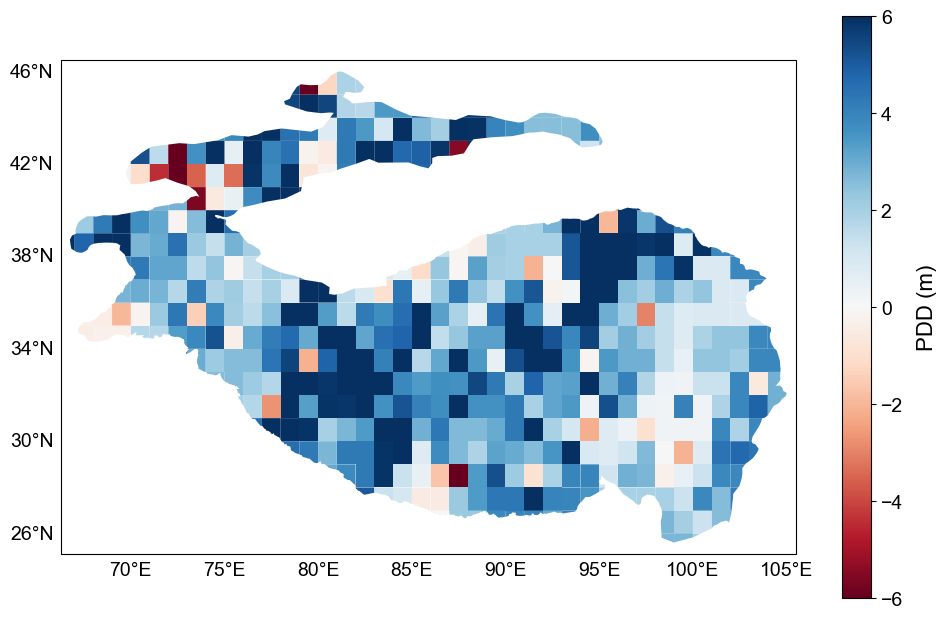

In [276]:
fig, ax = plt.subplots(1, 1, figsize=(10, 10), subplot_kw={'projection': ccrs.PlateCarree()})
lon_min, lon_max = grid10.bounds.minx.min(), grid10.bounds.maxx.max()
lat_min, lat_max = grid10.bounds.miny.min(), grid10.bounds.maxy.max()
ax.set_extent([lon_min-0.5, lon_max+0.5, lat_min-0.5, lat_max+0.5], crs=ccrs.PlateCarree())

grid10.plot(
    column='pdd',
    cmap='RdBu',
    vmin=-6,
    vmax=6,
    legend=True,
    ax=ax,
    legend_kwds={'shrink': 0.6},
    edgecolor='none'
)

cbar = ax.get_figure().get_axes()[-1]
cbar.set_ylabel('PDD (m)', fontsize=16, labelpad=10)
cbar.tick_params(labelsize=14)

gl=ax.gridlines(crs=ccrs.PlateCarree(),
                draw_labels=True,
                linewidth=0.001,
                color='gray',
                alpha=0,
                linestyle='--',
                xlocs=np.arange(-180,181,5),
                ylocs=np.arange(-90,91,4),
)
# 设置标签格式
gl.xlabel_style = {'size': 14, 'color': 'black'}
gl.ylabel_style = {'size': 14, 'color': 'black'}
gl.xformatter = LongitudeFormatter(zero_direction_label=False, number_format='.0f')
gl.yformatter = LatitudeFormatter(number_format='.0f')

gl.top_labels = False
gl.right_labels = False
gl.bottom_labels = True
gl.left_labels = True

plt.tight_layout()
plt.show()

In [ ]:
save_path=r'E:\revised_NCC_data\grid10_pdd\pdd_depth.pdf'
fig.savefig(
    save_path,
    dpi=1000,
    bbox_inches='tight',
    bbox_extra_artists=(
        ax,             
    )
)

In [169]:
def fill_missing_pdd_with_neighbors(grid10, var_name, max_iterations=5):
    pdd_filled = grid10[var_name].copy()
    grid10[var_name+'_orig'] = pdd_filled
    initial_miss_num = (pd.isna(pdd_filled) | (pdd_filled == 0)).sum()
    
    for iteration in range(max_iterations):
        missing_mask = pd.isna(pdd_filled) | (pdd_filled == 0)
        missing_indices = grid10.index[missing_mask]
        
        if len(missing_indices) == 0:
            break
        
        filled_count = 0
        
        for idx in missing_indices:
            current_x = grid10.loc[idx, 'x']
            current_y = grid10.loc[idx, 'y']
            
            # define the search radius
            search_radius = iteration + 1

            neighbor_mask = (
                (abs(grid10['x'] - current_x) <= search_radius) & 
                (abs(grid10['y'] - current_y) <= search_radius) &
                (~pd.isna(grid10[var_name])) & 
                (grid10[var_name] != 0) &
                (grid10.index != idx)  # exclude myself
            )
            
            neighbor_values = grid10.loc[neighbor_mask, var_name]
            
            if len(neighbor_values) >= 3:  # at least 3 neighbors
                median_value = neighbor_values.median()
                pdd_filled.loc[idx] = median_value
                filled_count += 1

    grid10[var_name] = pdd_filled
    
    remaining_miss_num = (pd.isna(pdd_filled) | (pdd_filled == 0)).sum()
    print(f'Fill {initial_miss_num-remaining_miss_num} values, remain {remaining_miss_num} missing values')
    
    return grid10

In [ ]:
grid10 = fill_missing_pdd_with_neighbors(grid10, 'pdd', max_iterations=5)

print(f'Original missing number: {np.sum((pd.isna(grid10["pdd_orig"])) | (grid10["pdd_orig"]==0))}')
print(f'Current missing number: {np.sum((pd.isna(grid10["pdd"])) | (grid10["pdd"]==0))}')

Fill 242 PDD values, remain 0 PDD values
Original missing number: 62
Current missing number: 0


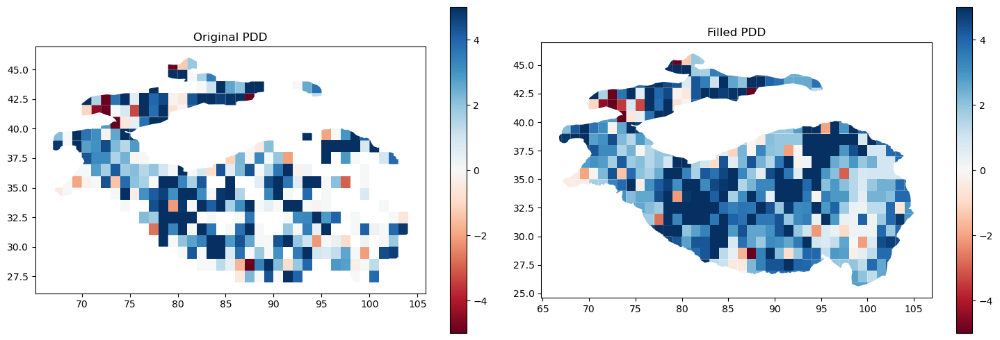

In [21]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))

grid10.plot(
    ax=ax1,
    column='pdd_orig',
    cmap='RdBu',
    vmin=-5,
    vmax=5,
    legend=True,
)
grid10.plot(
    ax=ax2,
    column='pdd',
    cmap='RdBu',
    vmin=-5,
    vmax=5,
    legend=True,
)
ax1.set_title('Original PDD')
ax2.set_title('Filled PDD')

plt.tight_layout()
plt.show()

In [ ]:
grid10.to_file(grid10_pdd_savepath, driver='ESRI Shapefile')

## Assign the glaciers to each grid

In [11]:
def clip_glaciers_to_grids(grid10, glacier_outlines, output_dir):

    os.makedirs(output_dir, exist_ok=True)
    # from gu.vector to gdf
    if hasattr(glacier_outlines, 'ds'):
        glacier_gdf = glacier_outlines.ds
    else:
        glacier_gdf = glacier_outlines
    # crs consistency
    if glacier_gdf.crs != grid10.crs:
        glacier_gdf = glacier_gdf.to_crs(grid10.crs)

    for idx, row in grid10.iterrows():
        grid_geom = row.geometry# WGS84
        grid_bounds = grid_geom.bounds
        grid_bbox = box(*grid_bounds)

        intersecting_glaciers = glacier_gdf[glacier_gdf.intersects(grid_bbox)]

        if len(intersecting_glaciers) > 0:
            clipped_glaciers = []
            for _, glacier in intersecting_glaciers.iterrows():
                clipped_geom = glacier.geometry.intersection(grid_bbox)
                if not clipped_geom.is_empty and clipped_geom.area > 0:
                    clipped_row = glacier.copy()
                    clipped_row.geometry = clipped_geom
                    clipped_glaciers.append(clipped_row)

            if clipped_glaciers:
                clipped_gdf = gpd.GeoDataFrame(clipped_glaciers, crs=glacier_gdf.crs)
                lon_str = f"E{int(row['x']):03d}"
                lat_str = f"N{int(row['y']):02d}"
                filename = f"{lat_str}{lon_str}_rgi.shp"
                filepath = os.path.join(output_dir, filename)
                
                clipped_gdf.to_file(filepath)
            print(f"{len(clipped_glaciers)} glaciers found for grid {lon_str} {lat_str}")
        else:
            print(f"No glaciers found for grid E{int(row['x']):03d} N{int(row['y']):02d}")


In [34]:
clip_glaciers_to_grids(grid10, glacier_outlines, grid10_rgi_savedir)

No glaciers found for grid E102 N27
660 glaciers found for grid E090 N30
No glaciers found for grid E090 N26
50 glaciers found for grid E079 N45
760 glaciers found for grid E078 N41
No glaciers found for grid E097 N27
5 glaciers found for grid E081 N44
324 glaciers found for grid E083 N43
No glaciers found for grid E101 N35
461 glaciers found for grid E082 N30
No glaciers found for grid E069 N41
812 glaciers found for grid E080 N35
No glaciers found for grid E096 N36
No glaciers found for grid E096 N27
1381 glaciers found for grid E077 N35
No glaciers found for grid E083 N37
No glaciers found for grid E099 N37
259 glaciers found for grid E081 N29
155 glaciers found for grid E096 N30
No glaciers found for grid E100 N30
9 glaciers found for grid E083 N32
No glaciers found for grid E104 N32
551 glaciers found for grid E082 N42
No glaciers found for grid E079 N29
No glaciers found for grid E102 N26
No glaciers found for grid E093 N42
2 glaciers found for grid E092 N31
25 glaciers found for

# ICESat-2

## Break the footprints to each grid

In [24]:
all_footprint_file = r'E:\revised_NCC_data\ICESat2_result\HMA_ICESat2_glacier_V6.csv'
grid_footprint_dir = r'E:\revised_NCC_data\ICESat2_result\grid10_footprint_glacier'

os.makedirs(grid_footprint_dir, exist_ok=True)

In [27]:
all_footprints = pd.read_csv(all_footprint_file, chunksize=200000, header=None)
chunk_count = 0
row_count = 0

for chunk in all_footprints:
    chunk_count += 1
    print(f"Processing chunk {chunk_count}: row {row_count+1} to {row_count+len(chunk)}")
    row_count += len(chunk)

    chunk.columns = ['lon', 'lat', 'days', 'h_li', 'egm96', 'egm2008', 
                    'quality_flag', 'hma22_region', 'gtn_region', 
                    'grid05_id', 'grid10_id', 'tp_flag', 'glacier_flag']
    valid_mask = (
        ~chunk['lon'].isna() &
        ~chunk['lat'].isna() 
    )
    valid_chunk = chunk[valid_mask]

    for idx, row in grid10.iterrows():
        lat_indicator = int(row['y'])
        lon_indicator = int(row['x'])

        selected_chunk = valid_chunk[
            (valid_chunk['lon']>=lon_indicator) &
            (valid_chunk['lon']<lon_indicator+1) &
            (valid_chunk['lat']>=lat_indicator) &
            (valid_chunk['lat']<lat_indicator+1)
        ]

        if len(selected_chunk) > 0:
            lon_str = f"E{int(row['x']):03d}"
            lat_str = f"N{int(row['y']):02d}"
            filename = f"{lat_str}{lon_str}_footprint.csv"
            filepath = os.path.join(grid_footprint_dir, filename)

            if os.path.exists(filepath):
                # add to original file
                selected_chunk.to_csv(filepath, mode='a', header=False, index=False)
            else:
                selected_chunk.to_csv(filepath, mode='w', header=False, index=False)
            print(f"Saved {len(selected_chunk)} footprints for grid {lon_str} {lat_str}")
        else:
            lon_str = f"E{int(row['x']):03d}"
            lat_str = f"N{int(row['y']):02d}"
            print(f"No footprints found for grid {lon_str} {lat_str}")

Processing chunk 1: row 1 to 200000
No footprints found for grid E102 N27
No footprints found for grid E090 N30
No footprints found for grid E090 N26
Saved 128 footprints for grid E079 N45
Saved 1578 footprints for grid E078 N41
No footprints found for grid E097 N27
No footprints found for grid E081 N44
No footprints found for grid E083 N43
No footprints found for grid E101 N35
No footprints found for grid E082 N30
No footprints found for grid E069 N41
Saved 1940 footprints for grid E080 N35
No footprints found for grid E096 N36
No footprints found for grid E096 N27
Saved 3884 footprints for grid E077 N35
No footprints found for grid E083 N37
No footprints found for grid E099 N37
Saved 10 footprints for grid E081 N29
No footprints found for grid E096 N30
No footprints found for grid E100 N30
No footprints found for grid E083 N32
No footprints found for grid E104 N32
No footprints found for grid E082 N42
No footprints found for grid E079 N29
No footprints found for grid E102 N26
No foot

## Calculate the shift vector when coregistering NASADEM and ICESat-2

In [197]:
def plot_two_dh(dh, dh_initial, save_path, title):
    fig, axes = plt.subplots(1, 2, figsize = (15, 6))

    plot_one_dh(dh_initial, axes[0], title+' without coregistration')
    plot_one_dh(dh, axes[1], title+' with coregistration')

    fig.savefig(save_path, dpi=600, bbox_inches='tight')

def plot_one_dh(dh, ax, title):
    dh_filtered = dh[(dh <= 50) & (dh >= -50)]
    bins = np.arange(-50, 52, 2)

    counts, bin_edges, patches = ax.hist(dh_filtered, bins=bins, alpha=0.7, facecolor='skyblue', edgecolor='black',linewidth=0.5)
    ax.set_title(title, fontsize=16)
    ax.set_xlabel('dh (m)', fontsize=15)
    ax.set_ylabel('Frequency', fontsize=15)
    #ax.set_xticks(bins)
    ax.set_xlim(-20, 20)
    ax.tick_params(labelsize=14)

    std_dh = np.nanstd(dh)
    median_dh = np.nanmedian(dh)
    mean_dh = np.nanmean(dh)
    stats_text = f'Std: {std_dh:.2f}m\nMedian: {median_dh:.2f}m\nMean: {mean_dh:.2f}m'
    ax.text(0.02, 0.98, stats_text, transform=ax.transAxes, 
            verticalalignment='top', bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.8))


def nuth_kaab_fit_func(aspect, a, b, c):
    """
    Nuth & Kääb (2011) 拟合函数
    
    y = a * cos(b - aspect) + c
    其中 y = dh/tan(slope), x = aspect
    """
    return a * np.cos(b - aspect) + c

def nuth_kaab_coregistration(grid_footprints, grid_dem, grid_slope, grid_aspect, 
                                                max_iterations=100, convergence_a_threshold=2, convergence_mse_threshold=0.005):
    """
    Coregister NASADEM to ICESat-2 usingNuth & Kääb (2011)
    
    Parameters:
    -----------
    grid_footprints : Dataframe, footprints not in glaciers
    grid_dem, grid_slope, grid_aspect: m, degree, degree
    max_iterations : int
    convergence_threshold : float m
        
    Returns:
    --------
    result : 
    """
    from scipy.optimize import curve_fit

    lon_initial = np.array(grid_footprints['lon'])
    lat_initial = np.array(grid_footprints['lat'])
    icesat2_initial = np.array(grid_footprints['h_egm96']) # EMG96

    valid_mask = (
        (~np.isnan(lon_initial)) &
        (~np.isnan(lat_initial)) &
        (~np.isnan(icesat2_initial)) &
        (icesat2_initial < 8800) &
        (icesat2_initial > 0)
    )

    lon_current = lon_initial[valid_mask].copy()
    lat_current = lat_initial[valid_mask].copy()
    icesat2_current = icesat2_initial[valid_mask].copy()

    if np.sum(valid_mask) < 100:
        return None, None, None, None, None, None

    total_lon_shift = 0.0
    total_lat_shift = 0.0
    iteration_results = []# store the results of each iteration
    prev_mse = np.inf

    R_earth_meters = 6371000 #m
    coords = (lon_current, lat_current)
    original_nasadem_values = grid_dem.interp_points(coords, method='linear')

    for iteration in range(max_iterations):
        coords = (lon_current, lat_current)
        nasadem_values = grid_dem.interp_points(coords, method='linear')
        slope_values = grid_slope.interp_points(coords, method='linear')
        aspect_values = grid_aspect.interp_points(coords, method='linear')

        dh = nasadem_values - icesat2_current

        valid_mask = (
            ~np.isnan(nasadem_values) &
            ~np.isnan(slope_values) &
            ~np.isnan(aspect_values) &
            (np.abs(dh) < 100) &
            (slope_values > 0.1)
        )

        if np.sum(valid_mask) < 100:
            return None, None, None, None, None, None

        dh_valid = dh[valid_mask]
        slope_valid = slope_values[valid_mask]
        aspect_valid = aspect_values[valid_mask]
        #拟合
        Y = dh_valid / np.tan(np.deg2rad(slope_valid)) # m
        X = np.deg2rad(aspect_valid) # rad

        popt, pcov = curve_fit(nuth_kaab_fit_func, X, Y, p0=[20, 1, 0], 
                                bounds=([-100, -2*np.pi, -np.inf], [100, 2*np.pi, np.inf]), # range
                                maxfev=5000, ftol=1e-8, xtol=1e-8, gtol=1e-8)
        a_fit_meters, b_fit_radians, c_fit_meters = popt

        Y_pred = nuth_kaab_fit_func(X, a_fit_meters, b_fit_radians, c_fit_meters)
        residuals = Y - Y_pred
        mse_current = np.mean(residuals**2) #MSE

        mean_lat_rad_for_conversion = np.deg2rad(np.mean(lat_current[valid_mask]))
        if np.abs(np.cos(mean_lat_rad_for_conversion)) < 1e-6: # 避免在极点附近除以零
            deg_per_meter_lon = 0.0
        else:
            deg_per_meter_lon = 1 / (R_earth_meters * np.cos(mean_lat_rad_for_conversion) * (np.pi/180)) # 每米经度对应的度数
        deg_per_meter_lat = 1 / (R_earth_meters * (np.pi/180)) # 每米纬度对应的度数

        DeltaE_meters = a_fit_meters * np.sin(b_fit_radians)
        DeltaN_meters = a_fit_meters * np.cos(b_fit_radians)
        shift_lon_deg = DeltaE_meters * deg_per_meter_lon # m to degree
        shift_lat_deg = DeltaN_meters * deg_per_meter_lat # m to degree

        converged_alpha = np.abs(a_fit_meters) < convergence_a_threshold #m
        converged_mse = np.abs((prev_mse - mse_current) / prev_mse) < convergence_mse_threshold if prev_mse != 0 else False 
        
        lon_current += shift_lon_deg
        lat_current += shift_lat_deg

        total_lon_shift += DeltaE_meters # m
        total_lat_shift += DeltaN_meters # m

        coords = (lon_current, lat_current)
        nasadem_values = grid_dem.interp_points(coords, method='linear')
        dh = nasadem_values - icesat2_current

        optimized_value = np.abs(np.nanstd(dh[valid_mask])*np.nanmedian(dh[valid_mask]))
        total_vshift = np.nanmedian(nasadem_values[valid_mask]-original_nasadem_values[valid_mask])

        current_iteration_info = {
            'iteration': iteration + 1,
            'a_fit_meters': a_fit_meters, 'b_fit_radians': b_fit_radians, 'c_fit_meters': c_fit_meters,
            'DeltaE_meters': DeltaE_meters, 'DeltaN_meters': DeltaN_meters,
            'shift_lon_deg': shift_lon_deg, 'shift_lat_deg': shift_lat_deg,
            'mse_current': mse_current,
            'optimized_value': optimized_value,
            'total_vshift': total_vshift,
            'total_lon_shift': total_lon_shift,
            'total_lat_shift': total_lat_shift,
            'converged_alpha': converged_alpha,
            'converged_mse': converged_mse,
            'num_points_fit': len(dh_valid),
            'dh': dh
        }
        iteration_results.append(current_iteration_info)

        if converged_alpha or converged_mse:
            break
    
    dh_initial = original_nasadem_values - icesat2_current
    if iteration < max_iterations - 1:
        return -total_lon_shift, -total_lat_shift, total_vshift, iteration+1, dh, dh_initial #ICESAT-2偏移，换算成DEM需要取负号
    else:
        optimized_values = [item['optimized_value'] for item in iteration_results]
        best_idx = np.argmin(optimized_values)
        best_iteration = iteration_results[best_idx]
        return -best_iteration['total_lon_shift'], -best_iteration['total_lat_shift'], best_iteration['total_vshift'], best_iteration['iteration'], best_iteration['dh'], dh_initial
        

In [234]:
nasa_slope_path = r'E:\HMA\NASADEM_HMA_slope.tif'
nasa_aspect_path = r'E:\HMA\NASADEM_HMA_aspect.tif'
coregister_fig_save_dir = r'E:\revised_NCC_data\ICESat2_result\coregister_fig'
grid10_path = r'E:\revised_NCC_data\grid10_pdd\HMA_fishnet_10_clip.shp'

os.makedirs(coregister_fig_save_dir, exist_ok=True)
grid10 = gpd.read_file(grid10_path)

nasa_slope = xdem.DEM(nasa_slope_path)
nasa_aspect = xdem.DEM(nasa_aspect_path)

Finished for grid 98E 25N
Finished for grid 99E 25N
Finished for grid 100E 25N
Finished for grid 85E 26N
Finished for grid 86E 26N
Finished for grid 87E 26N
Finished for grid 88E 26N
Finished for grid 89E 26N
Finished for grid 90E 26N
Finished for grid 91E 26N
Finished for grid 92E 26N
Finished for grid 93E 26N
Finished for grid 98E 26N
Finished for grid 99E 26N
Finished for grid 100E 26N
Finished for grid 101E 26N
Finished for grid 102E 26N
Finished for grid 81E 27N
Finished for grid 82E 27N
Finished for grid 83E 27N
Finished for grid 84E 27N
Finished for grid 85E 27N
Finished for grid 86E 27N
Finished for grid 87E 27N
Finished for grid 88E 27N
Finished for grid 89E 27N
Finished for grid 90E 27N
Finished for grid 91E 27N
Finished for grid 92E 27N
Finished for grid 93E 27N
Finished for grid 94E 27N
Finished for grid 95E 27N
Finished for grid 96E 27N
Finished for grid 97E 27N
Finished for grid 98E 27N
Finished for grid 99E 27N
Finished for grid 100E 27N
Finished for grid 101E 27N
Finish

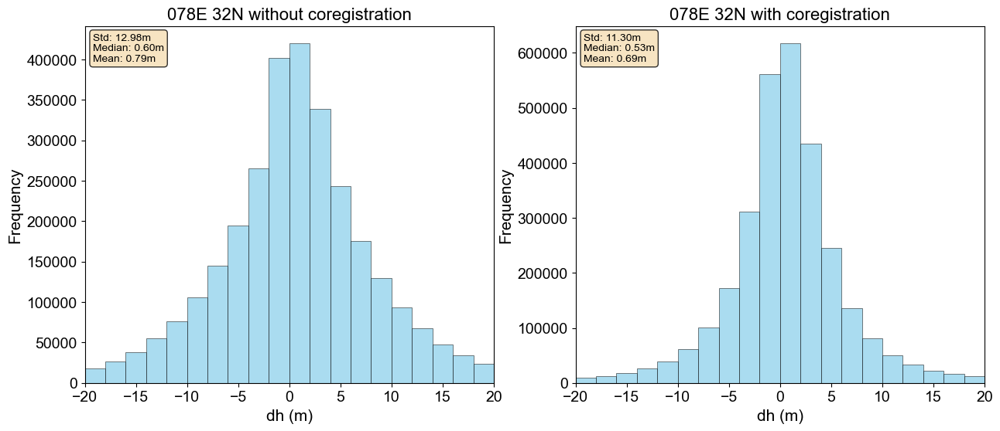

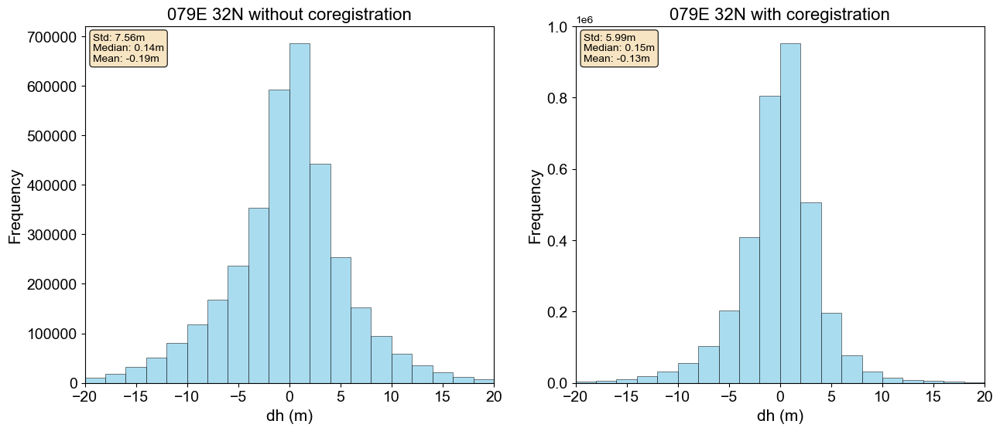

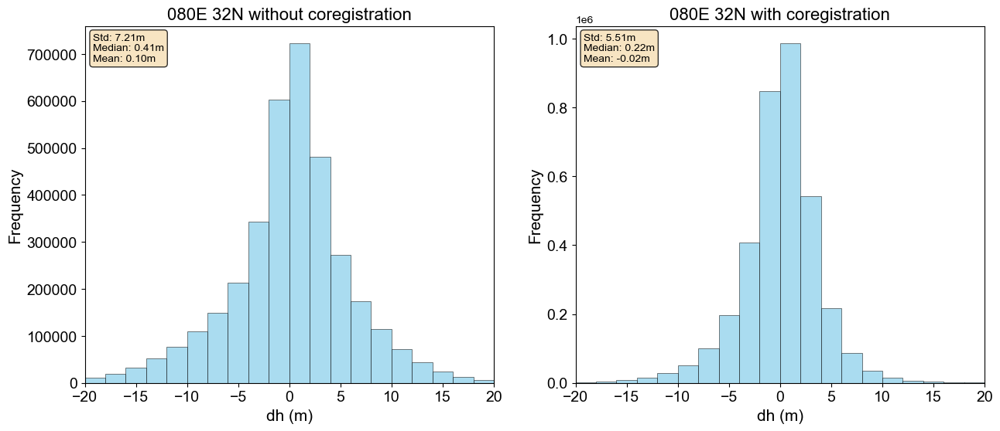

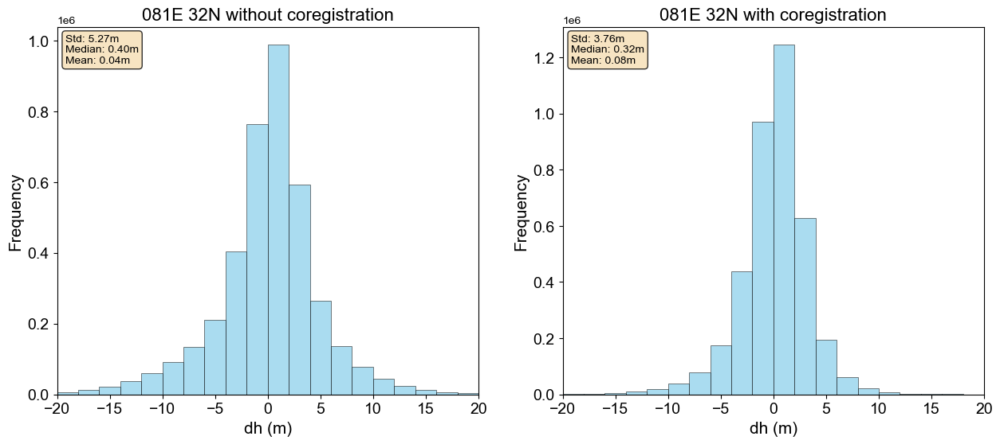

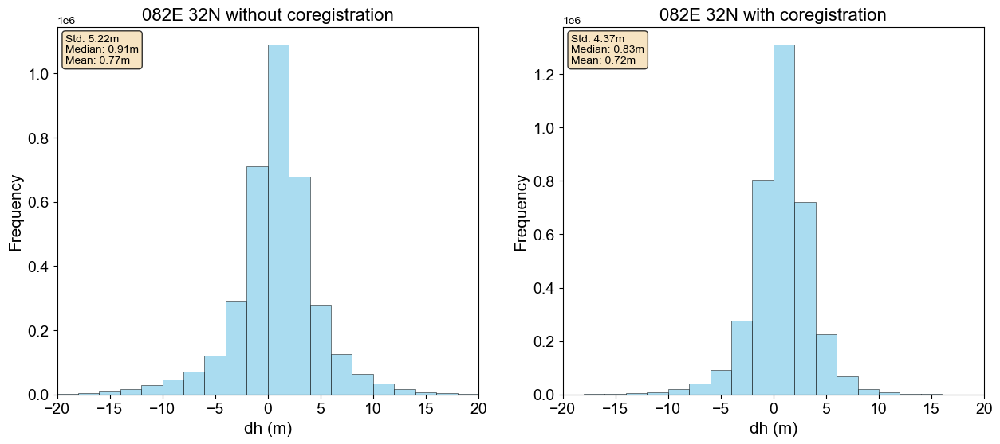

...

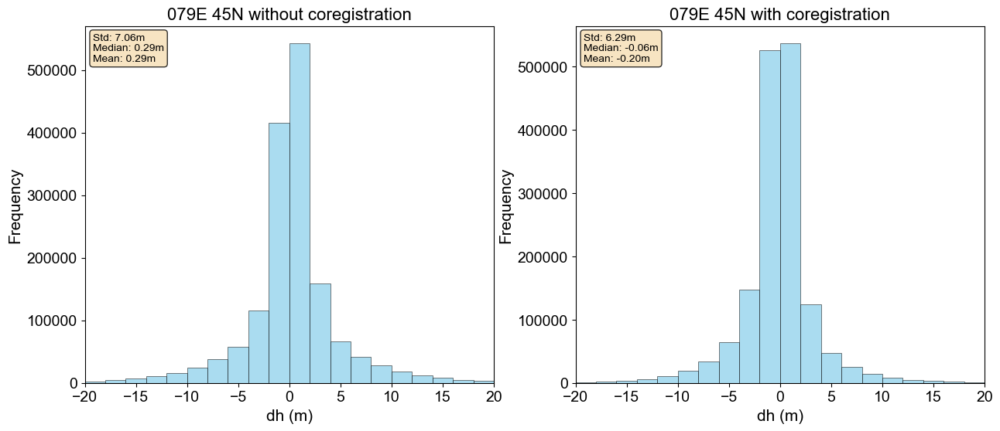

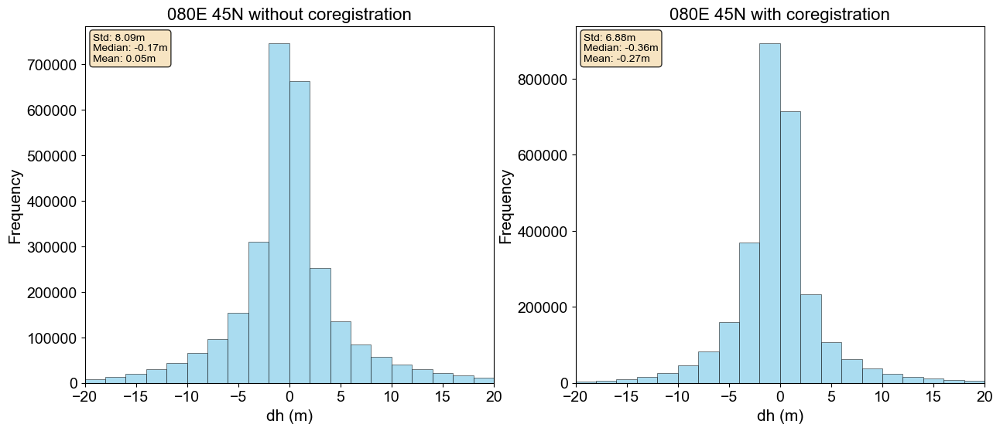

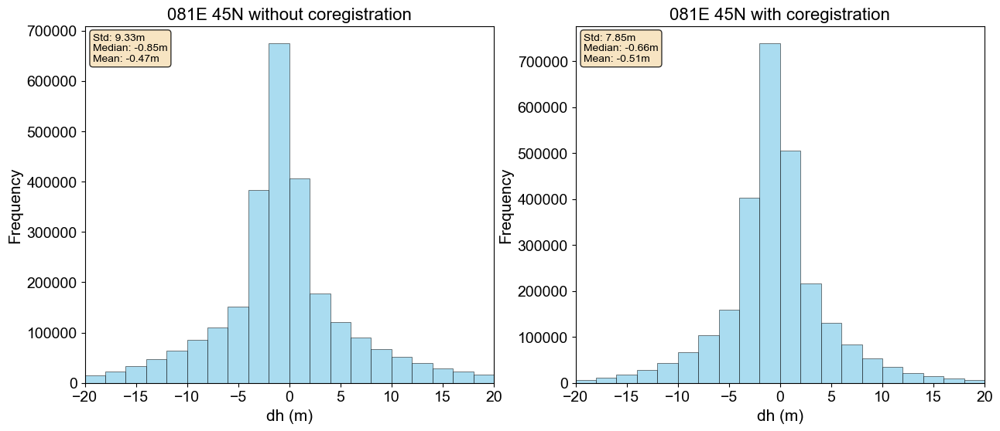

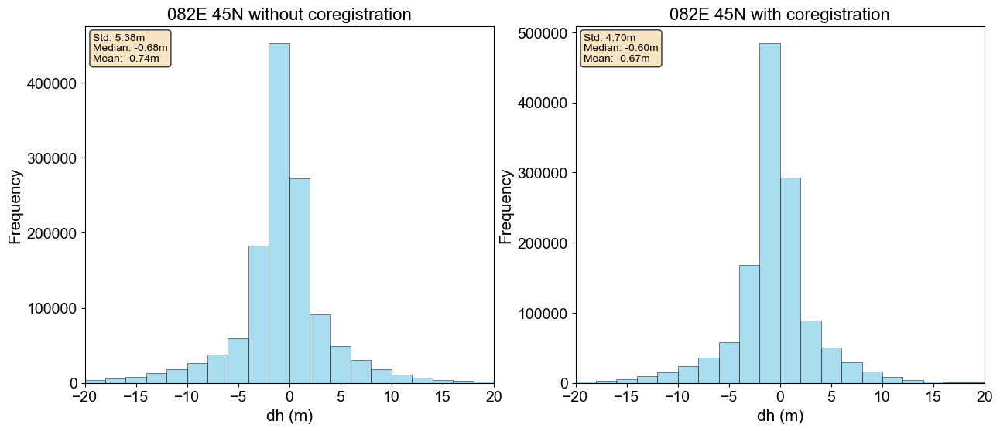

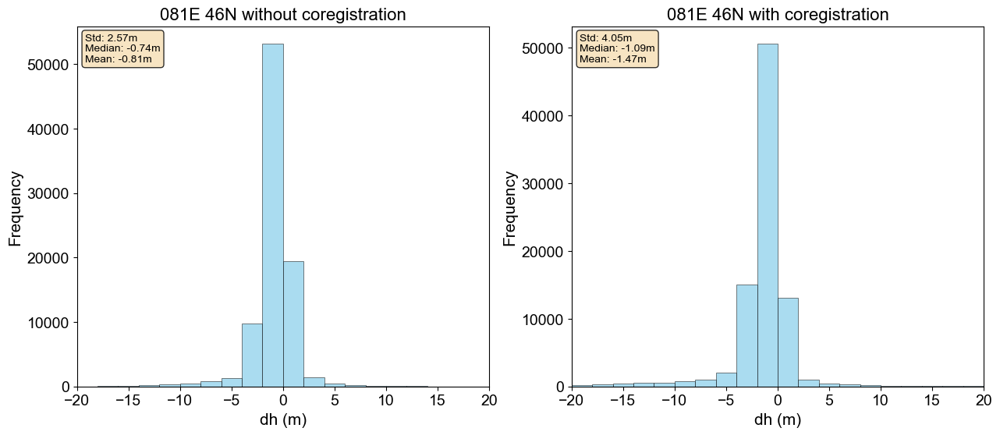

In [ ]:
grid_nonglacier_footprint_dir = r'E:\revised_NCC_data\ICESat2_result\grid10_footprint_nonglacier'
#grid10['coreg_vshift'] = np.nan # NASADEM and ICESat-2
#grid10['coreg_xshi'] = np.nan
#grid10['coreg_yshift'] = np.nan

csv_paths = getFilePathList(grid_nonglacier_footprint_dir, '.csv')

for csv_path in csv_paths:
    lon_indicator = int(os.path.basename(csv_path)[4:7])
    lat_indicator = int(os.path.basename(csv_path)[1:3])
    grid_idx = (grid10['x']>=lon_indicator) & (grid10['x']<lon_indicator+1) \
            & (grid10['y']>=lat_indicator) & (grid10['y']<lat_indicator+1)
    grid_id = grid10.loc[grid_idx, 'id'].values[0]

    if grid10.loc[grid_idx, 'coreg_vshift'].notna().all():
        print(f'Finished for grid {lon_indicator}E {lat_indicator}N')
        continue
    
    grid_geom = grid10.loc[grid_idx, 'geometry'].iloc[0]
    grid_bounds = grid_geom.bounds
    #grid_bbox = box(*grid_bounds)
    bbox_for_crop = list(grid_bounds) 
    bbox_for_crop[0] -= 0.1
    bbox_for_crop[1] -= 0.1
    bbox_for_crop[2] += 0.1
    bbox_for_crop[3] += 0.1

    grid_footprints = pd.read_csv(csv_path, header=None, on_bad_lines='skip')
    grid_footprints.columns = ['lon', 'lat', 'days', 'h_li', 'egm96', 'egm2008', 
                              'quality_flag']
    grid_footprints = grid_footprints.apply(pd.to_numeric, errors='coerce')
    grid_footprints = grid_footprints.dropna()
    grid_footprints = grid_footprints[grid_footprints['quality_flag']==0]
    '''
    ['lon', 'lat', 'days', 'h_li', 'egm96', 'egm2008', 
        'quality_flag', 'hma22_region', 'gtn_region', 
        'grid05_id', 'grid10_id', 'tp_flag', 'glacier_flag']
    '''
    grid_footprints['h_egm96'] = grid_footprints['h_li'] - grid_footprints['egm96']
    grid_footprints_gdf = gpd.GeoDataFrame(
        grid_footprints,
        geometry=gpd.points_from_xy(grid_footprints['lon'], grid_footprints['lat']),
        crs='EPSG:4326'
    )
    '''
    # extract rgi boundary for the grid
    grid_rgi_path = os.path.join(grid10_rgi_savedir, f'N{lat_indicator:02d}E{lon_indicator:03d}_rgi.shp')

    if os.path.exists(grid_rgi_path):
        grid_rgi = gpd.read_file(grid_rgi_path)

        if grid_rgi.crs != grid_footprints_gdf.crs:
            grid_rgi = grid_rgi.to_crs(grid_footprints_gdf.crs)
        
        # remain footprints not in glaciers
        glacier_union = grid_rgi.geometry.unary_union
        grid_footprints_gdf = grid_footprints_gdf[~grid_footprints_gdf.intersects(glacier_union)]
    else:
        pass
    '''
    # Crop NASADEM to the grid
    grid_dem = nasadem.crop(bbox_for_crop)# EGM96, lon/lat in WGS84
    grid_slope = nasa_slope.crop(bbox_for_crop)
    grid_aspect = nasa_aspect.crop(bbox_for_crop)

    if (grid_dem.crs.to_epsg() == grid10.crs.to_epsg()) & (len(grid_footprints_gdf) > 100):
        # fit shift vector
        lon_shift, lat_shift, vshift, iteration_num, dh, dh_initial = nuth_kaab_coregistration(grid_footprints_gdf, grid_dem, grid_slope, grid_aspect, 
                                                max_iterations=50, convergence_a_threshold=1, convergence_mse_threshold=0.005)# unit m
        fig_title = f'{lon_indicator:03d}E {lat_indicator:02d}N'
        fig_save_path = os.path.join(coregister_fig_save_dir, f'{lon_indicator:03d}E{lat_indicator:02d}N_coregistration.png')

        if lon_shift is not None:
            plot_two_dh(dh, dh_initial, fig_save_path, fig_title)

            grid10.loc[grid_idx, 'coreg_vshift'] = vshift
            grid10.loc[grid_idx, 'coreg_xshift'] = lon_shift
            grid10.loc[grid_idx, 'coreg_yshift'] = lat_shift #m, shift in NASADEM
            grid10.loc[grid_idx, 'coreg_iteration'] = iteration_num
            # dh: NASADEM-ICESAT-2

            print(f'Coregistration x {lon_shift:.2f} m, y {lat_shift:.2f} m, z {vshift:.2f} m, median dh {np.nanmedian(dh):.2f} m, for grid {lon_indicator}E {lat_indicator}N')
        else:
            print(f'Not enough valid data for grid {lon_indicator}E {lat_indicator}N')
    else:
        print(f'Not enough valid data for grid {lon_indicator}E {lat_indicator}N')

In [270]:
grid10.to_file(r'E:\revised_NCC_data\grid10_pdd\HMA_fishnet_10_clip_coreg_nonfilled.shp', driver='ESRI Shapefile')

In [316]:
def fill_missing_pdd_with_neighbors(grid10, var_name, max_iterations=5):
    pdd_filled = grid10[var_name].copy()
    grid10[var_name+'_orig'] = pdd_filled
    initial_miss_num = (pd.isna(pdd_filled)).sum()
    
    for iteration in range(max_iterations):
        missing_mask = pd.isna(pdd_filled)
        missing_indices = grid10.index[missing_mask]
        
        if len(missing_indices) == 0:
            break
        
        filled_count = 0
        
        for idx in missing_indices:
            current_x = grid10.loc[idx, 'x']
            current_y = grid10.loc[idx, 'y']
            
            # define the search radius
            search_radius = iteration + 1

            neighbor_mask = (
                (abs(grid10['x'] - current_x) <= search_radius) & 
                (abs(grid10['y'] - current_y) <= search_radius) &
                (~pd.isna(grid10[var_name])) & 
                (grid10.index != idx)  # exclude myself
            )
            
            neighbor_values = grid10.loc[neighbor_mask, var_name]
            
            if len(neighbor_values) >= 3:  # at least 3 neighbors
                median_value = neighbor_values.median()
                pdd_filled.loc[idx] = median_value
                filled_count += 1

    grid10[var_name] = pdd_filled
    
    remaining_miss_num = (pd.isna(pdd_filled)).sum()
    print(f'Fill {initial_miss_num-remaining_miss_num} values, remain {remaining_miss_num} missing values')
    
    return grid10

In [317]:
grid10 = fill_missing_pdd_with_neighbors(grid10, 'coreg_vshi', max_iterations=5)
grid10 = fill_missing_pdd_with_neighbors(grid10, 'coreg_xshi', max_iterations=5)
grid10 = fill_missing_pdd_with_neighbors(grid10, 'coreg_yshi', max_iterations=5)
grid10.to_file(r'E:\revised_NCC_data\grid10_pdd\HMA_fishnet_10_clip_coreg_filled.shp', driver='ESRI Shapefile')

Fill 3 values, remain 0 missing values
Fill 3 values, remain 0 missing values
Fill 3 values, remain 0 missing values


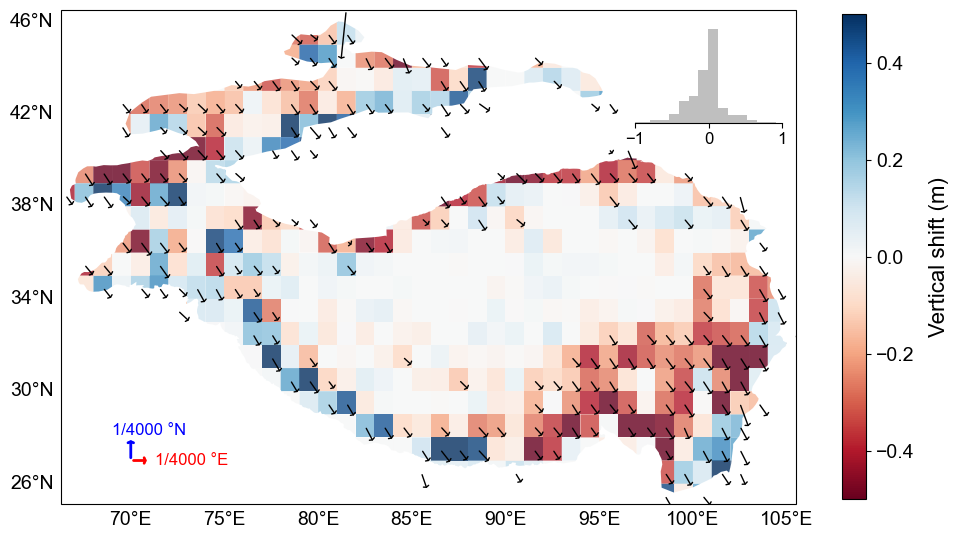

In [337]:
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
from matplotlib.patches import FancyArrowPatch
import cartopy.crs as ccrs
from cartopy.mpl.ticker import LongitudeFormatter, LatitudeFormatter

arrow_scale = 4000 # scale the shift vector for better visualization
fig, ax = plt.subplots(1, 1, figsize=(10, 10), subplot_kw={'projection': ccrs.PlateCarree()})

lon_min, lon_max = grid10.bounds.minx.min(), grid10.bounds.maxx.max()
lat_min, lat_max = grid10.bounds.miny.min(), grid10.bounds.maxy.max()
ax.set_extent([lon_min-0.5, lon_max+0.5, lat_min-0.5, lat_max+0.5], crs=ccrs.PlateCarree())

valid_mask = (grid10['coreg_xshi'].notna()) & \
            (grid10['coreg_yshi'].notna()) & \
                (grid10['coreg_vshi'].notna())

grid_valid = grid10[valid_mask].copy()
grid_valid['horizontal_shift'] = np.sqrt(grid_valid['coreg_xshi']**2 + grid_valid['coreg_yshi']**2)

grid_valid.plot(
    ax=ax,
    column='coreg_vshi',
    cmap='RdBu',
    vmin=-0.5,
    vmax=0.5,
    alpha=0.8,
    legend=True,
    legend_kwds={'shrink': 0.5},
    edgecolor='none'
)
# plot arrow in the center of each grid

for idx, row in grid_valid.iterrows():
    lon_indicator = int(row['x'])
    lat_indicator = int(row['y'])
    x_start = lon_indicator + 0.5
    y_start = lat_indicator + 0.5

    m_to_lon = arrow_scale / (111320 * np.cos(np.radians(y_start)))
    m_to_lat = arrow_scale / 111320

    linewidth = 1#max(0.3, min(1.5, row['horizontal_shift']/20))

    if abs(row['coreg_vshi'])>0.1:
        arrow = FancyArrowPatch(
            (x_start, y_start),
            (x_start + row['coreg_xshi']*m_to_lon, y_start + row['coreg_yshi']*m_to_lat),
            arrowstyle='->,head_width=2,head_length=0.8',
            linewidth=linewidth,
            color='black',
            zorder=5
        )
        ax.add_patch(arrow)

gl=ax.gridlines(crs=ccrs.PlateCarree(),
                draw_labels=True,
                linewidth=0.001,
                color='gray',
                alpha=0,
                linestyle='--',
                xlocs=np.arange(-180,181,5),
                ylocs=np.arange(-90,91,4),
)

gl.xlabel_style = {'size': 14, 'color': 'black'}
gl.ylabel_style = {'size': 14, 'color': 'black'}
gl.xformatter = LongitudeFormatter(zero_direction_label=False, number_format='.0f')
gl.yformatter = LatitudeFormatter(number_format='.0f')
gl.top_labels = False
gl.right_labels = False
gl.bottom_labels = True
gl.left_labels = True

legend_x = 70
legend_y = 27
horizontal_arrow = FancyArrowPatch(
    (legend_x, legend_y),
    (legend_x + 1, legend_y),
    arrowstyle='->,head_width=2,head_length=0.8',
    linewidth=2,
    color='red',
    zorder=10,
    transform=ccrs.PlateCarree()
)
ax.add_patch(horizontal_arrow)
ax.text(legend_x + 1.3, legend_y, 
        f'1/{arrow_scale} °E', fontsize=12, ha='left', color='red', va='center')

vertical_arrow = FancyArrowPatch(
    (legend_x, legend_y),
    (legend_x, legend_y + 1),
    arrowstyle='->,head_width=2,head_length=0.8',
    linewidth=2,
    color='blue',
    zorder=10,
    transform=ccrs.PlateCarree()
)
ax.add_patch(vertical_arrow)
ax.text(legend_x - 1, legend_y + 1.3, 
        f'1/{arrow_scale} °N', fontsize=12, va='center', color='blue')

cbar = ax.get_figure().get_axes()[-1]
cbar.set_ylabel('Vertical shift (m)', fontsize=16, labelpad=10)
cbar.tick_params(labelsize=14)

hist_ax = inset_axes(ax, width="20%", height="20%", 
                     loc='upper right',
                     bbox_to_anchor=(0, 0, 1, 1),
                     bbox_transform=ax.transAxes,
                     borderpad=1)
hist_ax.hist(grid10['coreg_vshi'], bins=25, edgecolor='none', color='gray', alpha=0.5)
hist_ax.yaxis.set_visible(False)
hist_ax.spines['top'].set_visible(False)
hist_ax.spines['right'].set_visible(False)
hist_ax.spines['left'].set_visible(False)
hist_ax.set_xlim(-1,1)
hist_ax.tick_params(labelsize=12)
hist_ax.set_xticks([-1,0,1])

plt.tight_layout()
plt.show()

In [341]:
save_path=r'E:\revised_NCC_data\grid10_pdd\coregistration_grid10.png'
all_axes = fig.get_axes()
fig.savefig(
    save_path,
    dpi=1000,
    bbox_inches='tight',
    bbox_extra_artists=all_axes
)

# CryoSat2

## Seperate glacier and non-glacier footprints and assign to grids

In [ ]:
txt_file = r'E:\revised_NCC_data\CryoSat2_result\HMA_cryosat2_TEMPO_SWATH_POINT.txt'
output_file_inrgi = r'E:\revised_NCC_data\CryoSat2_result\HMA_cryosat2_TEMPO_SWATH_POINT_glacierv2.txt'
output_file_outrgi = r'E:\revised_NCC_data\CryoSat2_result\HMA_cryosat2_TEMPO_SWATH_POINT_nonglacier.txt'

output_dir_inrgi = r'E:\revised_NCC_data\CryoSat2_result\grid10_footprint_glacier'
output_dir_outrgi = r'E:\revised_NCC_data\CryoSat2_result\grid10_footprint_nonglacier'

rgi_file_list = [os.path.join(root, file) for root, dirs, files in os.walk(grid10_rgi_savedir) for file in files if file.endswith('.shp')]

In [ ]:
def assign_to_grid(footprints, grid10, grid_footprint_dir):
    # footprints-Dataframe
    os.makedirs(grid_footprint_dir, exist_ok=True)

    for idx, row in grid10.iterrows():
        lat_indicator = int(row['y'])
        lon_indicator = int(row['x'])

        selected_chunk = footprints[
            (footprints['lon']>=lon_indicator) &
            (footprints['lon']<lon_indicator+1) &
            (footprints['lat']>=lat_indicator) &
            (footprints['lat']<lat_indicator+1)
        ]

        if len(selected_chunk) > 0:
            lon_str = f"E{int(row['x']):03d}"
            lat_str = f"N{int(row['y']):02d}"
            filename = f"{lat_str}{lon_str}_footprint.csv"
            filepath = os.path.join(grid_footprint_dir, filename)

            if os.path.exists(filepath):
                # add to original file
                selected_chunk.to_csv(filepath, mode='a', header=False, index=False)
            else:
                selected_chunk.to_csv(filepath, mode='w', header=False, index=False)
            print(f"Saved {len(selected_chunk)} footprints for grid {lon_str} {lat_str}")
        else:
            lon_str = f"E{int(row['x']):03d}"
            lat_str = f"N{int(row['y']):02d}"
            print(f"No footprints found for grid {lon_str} {lat_str}")

In [182]:
all_footprints = pd.read_csv(txt_file, chunksize=1000000, header=None)

footprints_inrgi = []
footprints_outrgi = []
chunk_count = 0
row_count = 0

for chunk in all_footprints:
    chunk_count += 1
    print(f"Processing chunk {chunk_count}: row {row_count+1} to {row_count+len(chunk)}")
    row_count += len(chunk)

    chunk.columns = ['lat', 'lon', 'ele', 'days', 'year', 'month', 
                    'geoEGM96', 'uncert']
    valid_mask = (
        ~chunk['lon'].isna() &
        ~chunk['lat'].isna() 
    )
    valid_chunk = chunk[valid_mask].copy()

    gdf_chunk = gpd.GeoDataFrame(
        valid_chunk,
        geometry=gpd.points_from_xy(valid_chunk['lon'], valid_chunk['lat']),
        crs='EPSG:4326'
    )
    in_rgi_mask = pd.Series(False, index=gdf_chunk.index)

    for rgi_file in rgi_file_list:
        rgi = gpd.read_file(rgi_file)
        
        if rgi.crs != gdf_chunk.crs:
            rgi = rgi.to_crs(gdf_chunk.crs)

        joined = gpd.sjoin(gdf_chunk, rgi, how='inner', predicate='within')
        in_rgi_mask.loc[joined.index] = True

    footprints_inrgi.append(gdf_chunk[in_rgi_mask].drop(columns='geometry'))
    footprints_outrgi.append(gdf_chunk[~in_rgi_mask].drop(columns='geometry'))


footprints_inrgi = pd.concat(footprints_inrgi, ignore_index=True)
footprints_outrgi = pd.concat(footprints_outrgi, ignore_index=True)

print(f"  RGI in: {len(footprints_inrgi)}")
print(f"  RGI out: {len(footprints_outrgi)}")

# lon <-> lat
footprints_inrgi = footprints_inrgi[['lon', 'lat', 'ele', 'days', 'year', 'month', 'geoEGM96', 'uncert']]
footprints_outrgi = footprints_outrgi[['lon', 'lat', 'ele', 'days', 'year', 'month', 'geoEGM96', 'uncert']]

# saved to txt
footprints_inrgi.to_csv(output_file_inrgi, index=False, header=False, sep=' ')
footprints_outrgi.to_csv(output_file_outrgi, index=False, header=False, sep=' ')


Processing chunk 1: row 1 to 1000000
Processing chunk 2: row 1000001 to 2000000
Processing chunk 3: row 2000001 to 3000000
Processing chunk 4: row 3000001 to 4000000
Processing chunk 5: row 4000001 to 5000000
Processing chunk 6: row 5000001 to 6000000
Processing chunk 7: row 6000001 to 7000000
Processing chunk 8: row 7000001 to 8000000
Processing chunk 9: row 8000001 to 9000000
Processing chunk 10: row 9000001 to 10000000
Processing chunk 11: row 10000001 to 11000000
Processing chunk 12: row 11000001 to 12000000
Processing chunk 13: row 12000001 to 13000000
Processing chunk 14: row 13000001 to 14000000
Processing chunk 15: row 14000001 to 15000000
Processing chunk 16: row 15000001 to 16000000
Processing chunk 17: row 16000001 to 17000000
Processing chunk 18: row 17000001 to 18000000
Processing chunk 19: row 18000001 to 19000000
Processing chunk 20: row 19000001 to 20000000
Processing chunk 21: row 20000001 to 21000000
Processing chunk 22: row 21000001 to 22000000
Processing chunk 23: r

In [186]:
print('Assign glacier footprints to grid...')
assign_to_grid(footprints_inrgi, grid10, output_dir_inrgi)

print('Assign non-glacier footprints to grid...')
assign_to_grid(footprints_outrgi, grid10, output_dir_outrgi)

Assign glacier footprints to grid...
No footprints found for grid E102 N27
Saved 38386 footprints for grid E090 N30
No footprints found for grid E090 N26
Saved 308 footprints for grid E079 N45
Saved 62221 footprints for grid E078 N41
No footprints found for grid E097 N27
Saved 1 footprints for grid E081 N44
Saved 194614 footprints for grid E083 N43
No footprints found for grid E101 N35
Saved 131214 footprints for grid E082 N30
No footprints found for grid E069 N41
Saved 1046329 footprints for grid E080 N35
No footprints found for grid E096 N36
No footprints found for grid E096 N27
Saved 841094 footprints for grid E077 N35
No footprints found for grid E083 N37
No footprints found for grid E099 N37
Saved 16271 footprints for grid E081 N29
Saved 1263 footprints for grid E096 N30
No footprints found for grid E100 N30
Saved 3952 footprints for grid E083 N32
No footprints found for grid E104 N32
Saved 72374 footprints for grid E082 N42
No footprints found for grid E079 N29
No footprints foun

In [187]:
footprints_outrgi_gdf = gpd.GeoDataFrame(
    footprints_outrgi,
    geometry=gpd.points_from_xy(footprints_outrgi['lon'], footprints_outrgi['lat']),
    crs='EPSG:4326'
)

footprints_outrgi_gdf.to_file(r'E:\revised_NCC_data\CryoSat2_result\non_glacier_footprints.shp', driver='ESRI Shapefile')

In [ ]:
output_file_inrgi = r'E:\revised_NCC_data\CryoSat2_result\HMA_cryosat_TEMPO_SWATH_POINT_glacier_v2.txt'
footprints_inrgi = pd.read_csv(output_file_inrgi, header=None)

footprints_inrgi = footprints_inrgi.apply(pd.to_numeric, errors='coerce')
footprints_inrgi = footprints_inrgi.dropna()

footprints_inrgi.to_csv(output_file_inrgi.replace('v2.txt', 'v3.txt'), index=False, header=False, sep=' ')
footprints_inrgi.columns = ['lon', 'lat', 'ele', 'days', 'year', 'month', 
                    'geoEGM96', 'uncert', 'HMA22', 'GTN', 'grid05', 'grid10', 'tp_flag']

print('Assign glacier footprints to grid...')
assign_to_grid(footprints_inrgi, grid10, output_dir_inrgi)
'''
% 第1列 lon
% 第2列 lat
% 第3 ele
% 第4 days, since 2000-01-01-00:00:00
% 第5 year
% 第6 month
% 第7 geoid %EGM96
% 第8 uncert
% 第9 HMA22区域编号
% 第10 GTN编号  
% 第11 0.5°网格编号
% 第12 1°网格编号
% 第13 青藏高原标识
'''